In [102]:
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib.pyplot import *
import matplotlib.pyplot as plt
import scipy as sts
from scipy import stats
from scipy.stats import zscore
from sklearn.linear_model import LinearRegression,Lasso,Ridge
from sklearn.model_selection import train_test_split,GridSearchCV, cross_val_score
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import GradientBoostingRegressor, ExtraTreesRegressor

import warnings
warnings.filterwarnings('ignore')


In [4]:
Train = pd.read_csv('FR_Housing_train.csv')
Test = pd.read_csv('FR_Housing_test.csv')

In [5]:
pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)

In [6]:
Train.describe().T

,count,mean,std,min,25%,50%,75%,max
Id,1168.0,724.136130,416.159877,1.0,360.50,714.5,1079.5,1460.0
MSSubClass,1168.0,56.767979,41.940650,20.0,20.00,50.0,70.0,190.0
LotFrontage,954.0,70.988470,24.828750,21.0,60.00,70.0,80.0,313.0
LotArea,1168.0,10484.749144,8957.442311,1300.0,7621.50,9522.5,11515.5,164660.0
OverallQual,1168.0,6.104452,1.390153,1.0,5.00,6.0,7.0,10.0
OverallCond,1168.0,5.595890,1.124343,1.0,5.00,5.0,6.0,9.0
YearBuilt,1168.0,1970.930651,30.145255,1875.0,1954.00,1972.0,2000.0,2010.0
YearRemodAdd,1168.0,1984.758562,20.785185,1950.0,1966.00,1993.0,2004.0,2010.0
MasVnrArea,1161.0,102.310078,182.595606,0.0,0.00,0.0,160.0,1600.0
BsmtFinSF1,1168.0,444.726027,462.664785,0.0,0.00,385.5,714.5,5644.0


In [7]:
Test.describe().T

,count,mean,std,min,25%,50%,75%,max
Id,292.0,755.955479,442.565228,6.0,377.75,778.0,1152.25,1456.0
MSSubClass,292.0,57.414384,43.780649,20.0,20.00,50.0,70.00,190.0
LotFrontage,247.0,66.425101,21.726343,21.0,53.50,65.0,79.00,150.0
LotArea,292.0,10645.143836,13330.669795,1526.0,7200.00,9200.0,11658.75,215245.0
OverallQual,292.0,6.078767,1.356147,3.0,5.00,6.0,7.00,10.0
OverallCond,292.0,5.493151,1.063267,3.0,5.00,5.0,6.00,9.0
YearBuilt,292.0,1972.616438,30.447016,1872.0,1954.00,1976.0,2001.00,2009.0
YearRemodAdd,292.0,1985.294521,20.105792,1950.0,1968.00,1994.0,2003.25,2010.0
MasVnrArea,291.0,109.171821,175.030021,0.0,0.00,0.0,180.00,1031.0
BsmtFinSF1,292.0,439.294521,429.559675,0.0,0.00,369.5,700.50,1767.0


In [8]:
Train.isnull().sum()

Id                  0
MSSubClass          0
MSZoning            0
LotFrontage       214
LotArea             0
Street              0
Alley            1091
LotShape            0
LandContour         0
Utilities           0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
OverallQual         0
OverallCond         0
YearBuilt           0
YearRemodAdd        0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType          7
MasVnrArea          7
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual           30
BsmtCond           30
BsmtExposure       31
BsmtFinType1       30
BsmtFinSF1          0
BsmtFinType2       31
BsmtFinSF2          0
BsmtUnfSF           0
TotalBsmtSF         0
Heating             0
HeatingQC           0
CentralAir          0
Electrical          0
1stFlrSF            0
2ndFlrSF            0
LowQualFin

In [9]:
Train.shape

(1168, 81)

In [10]:
Test.shape

(292, 80)

In [11]:
Test.isnull().sum()

Id                 0
MSSubClass         0
MSZoning           0
LotFrontage       45
LotArea            0
Street             0
Alley            278
LotShape           0
LandContour        0
Utilities          0
LotConfig          0
LandSlope          0
Neighborhood       0
Condition1         0
Condition2         0
BldgType           0
HouseStyle         0
OverallQual        0
OverallCond        0
YearBuilt          0
YearRemodAdd       0
RoofStyle          0
RoofMatl           0
Exterior1st        0
Exterior2nd        0
MasVnrType         1
MasVnrArea         1
ExterQual          0
ExterCond          0
Foundation         0
BsmtQual           7
BsmtCond           7
BsmtExposure       7
BsmtFinType1       7
BsmtFinSF1         0
BsmtFinType2       7
BsmtFinSF2         0
BsmtUnfSF          0
TotalBsmtSF        0
Heating            0
HeatingQC          0
CentralAir         0
Electrical         1
1stFlrSF           0
2ndFlrSF           0
LowQualFinSF       0
GrLivArea          0
BsmtFullBath 

In [12]:
Train.columns

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating',
       'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual',
       'GarageCond', 'PavedDrive

In [13]:
Test.columns

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating',
       'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual',
       'GarageCond', 'PavedDrive

In [14]:
Train.dtypes

Id                 int64
MSSubClass         int64
MSZoning          object
LotFrontage      float64
LotArea            int64
Street            object
Alley             object
LotShape          object
LandContour       object
Utilities         object
LotConfig         object
LandSlope         object
Neighborhood      object
Condition1        object
Condition2        object
BldgType          object
HouseStyle        object
OverallQual        int64
OverallCond        int64
YearBuilt          int64
YearRemodAdd       int64
RoofStyle         object
RoofMatl          object
Exterior1st       object
Exterior2nd       object
MasVnrType        object
MasVnrArea       float64
ExterQual         object
ExterCond         object
Foundation        object
BsmtQual          object
BsmtCond          object
BsmtExposure      object
BsmtFinType1      object
BsmtFinSF1         int64
BsmtFinType2      object
BsmtFinSF2         int64
BsmtUnfSF          int64
TotalBsmtSF        int64
Heating           object


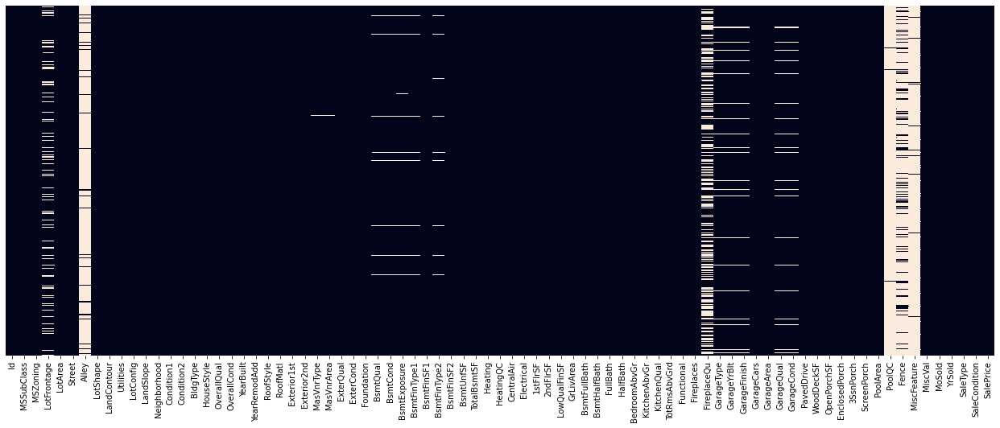

In [15]:
plt.figure(figsize=(22,8))
sns.heatmap(Train.isnull(),yticklabels=False,cbar=False)

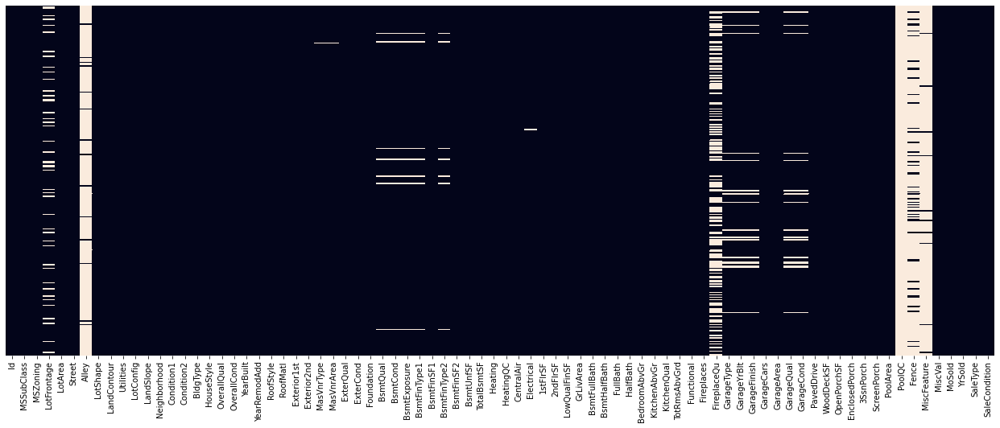

In [16]:
plt.figure(figsize=(22,8))
sns.heatmap(Test.isnull(),yticklabels=False,cbar=False)

In [17]:
Col_with_na=[nan_col for nan_col in Train.columns if Train[nan_col].isnull().sum()>1]

## 2- step print the feature name and the percentage of missing values

for nan_col in Col_with_na:
    print(nan_col, np.round(Train[nan_col].isnull().mean(), 4),  ' % missing values')

LotFrontage 0.1832  % missing values
Alley 0.9341  % missing values
MasVnrType 0.006  % missing values
MasVnrArea 0.006  % missing values
BsmtQual 0.0257  % missing values
BsmtCond 0.0257  % missing values
BsmtExposure 0.0265  % missing values
BsmtFinType1 0.0257  % missing values
BsmtFinType2 0.0265  % missing values
FireplaceQu 0.4717  % missing values
GarageType 0.0548  % missing values
GarageYrBlt 0.0548  % missing values
GarageFinish 0.0548  % missing values
GarageQual 0.0548  % missing values
GarageCond 0.0548  % missing values
PoolQC 0.994  % missing values
Fence 0.7971  % missing values
MiscFeature 0.9623  % missing values


In [18]:
Col_with_na=[nan_col for nan_col in Test.columns if Test[nan_col].isnull().sum()>1]


for nan_col in Col_with_na:                                                                 ## printing the column name and the percentage of missing values

    print(nan_col, np.round(Test[nan_col].isnull().mean(), 4),  ' % missing values')

LotFrontage 0.1541  % missing values
Alley 0.9521  % missing values
BsmtQual 0.024  % missing values
BsmtCond 0.024  % missing values
BsmtExposure 0.024  % missing values
BsmtFinType1 0.024  % missing values
BsmtFinType2 0.024  % missing values
FireplaceQu 0.476  % missing values
GarageType 0.0582  % missing values
GarageYrBlt 0.0582  % missing values
GarageFinish 0.0582  % missing values
GarageQual 0.0582  % missing values
GarageCond 0.0582  % missing values
PoolQC 1.0  % missing values
Fence 0.8493  % missing values
MiscFeature 0.9658  % missing values


In [19]:
Train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1168 entries, 0 to 1167
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1168 non-null   int64  
 1   MSSubClass     1168 non-null   int64  
 2   MSZoning       1168 non-null   object 
 3   LotFrontage    954 non-null    float64
 4   LotArea        1168 non-null   int64  
 5   Street         1168 non-null   object 
 6   Alley          77 non-null     object 
 7   LotShape       1168 non-null   object 
 8   LandContour    1168 non-null   object 
 9   Utilities      1168 non-null   object 
 10  LotConfig      1168 non-null   object 
 11  LandSlope      1168 non-null   object 
 12  Neighborhood   1168 non-null   object 
 13  Condition1     1168 non-null   object 
 14  Condition2     1168 non-null   object 
 15  BldgType       1168 non-null   object 
 16  HouseStyle     1168 non-null   object 
 17  OverallQual    1168 non-null   int64  
 18  OverallC

In [20]:
Test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 292 entries, 0 to 291
Data columns (total 80 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             292 non-null    int64  
 1   MSSubClass     292 non-null    int64  
 2   MSZoning       292 non-null    object 
 3   LotFrontage    247 non-null    float64
 4   LotArea        292 non-null    int64  
 5   Street         292 non-null    object 
 6   Alley          14 non-null     object 
 7   LotShape       292 non-null    object 
 8   LandContour    292 non-null    object 
 9   Utilities      292 non-null    object 
 10  LotConfig      292 non-null    object 
 11  LandSlope      292 non-null    object 
 12  Neighborhood   292 non-null    object 
 13  Condition1     292 non-null    object 
 14  Condition2     292 non-null    object 
 15  BldgType       292 non-null    object 
 16  HouseStyle     292 non-null    object 
 17  OverallQual    292 non-null    int64  
 18  OverallCon

In [21]:
Test.shape

(292, 80)

In [22]:
Train.shape

(1168, 81)

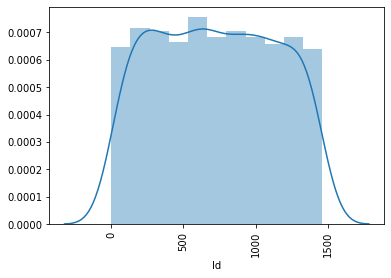

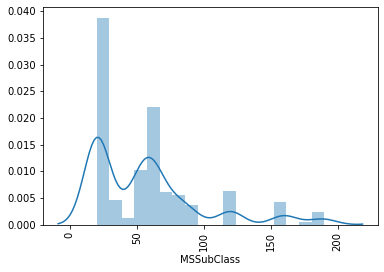

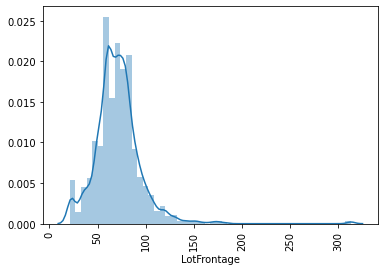

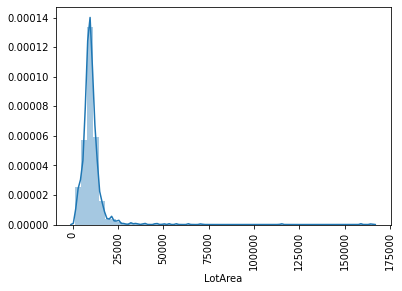

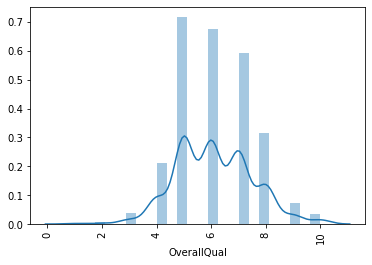

...

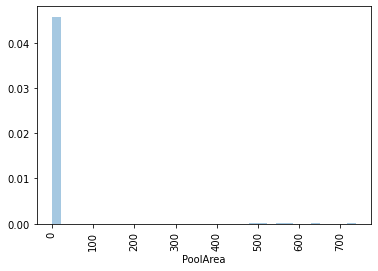

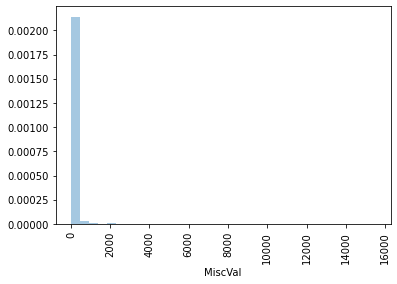

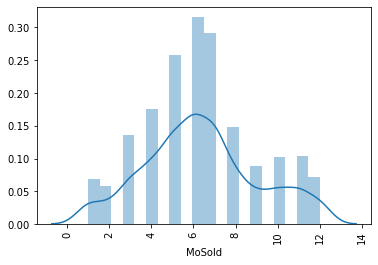

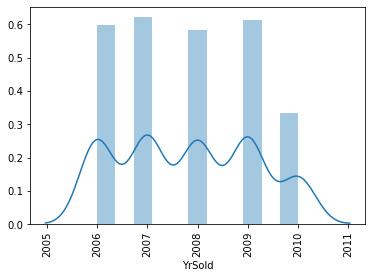

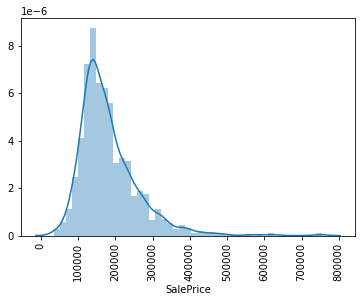

In [23]:
for i in Train.describe().columns:
    sns.distplot(Train[i])
    plt.xticks(rotation=90)
    plt.show()

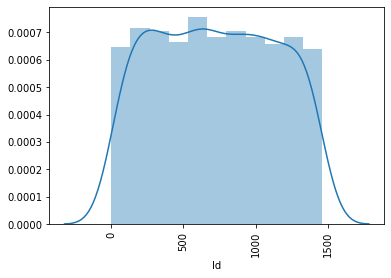

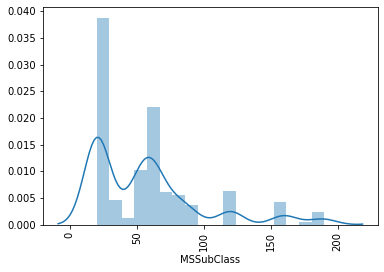

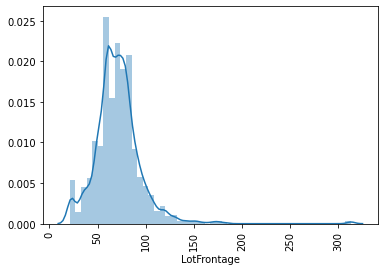

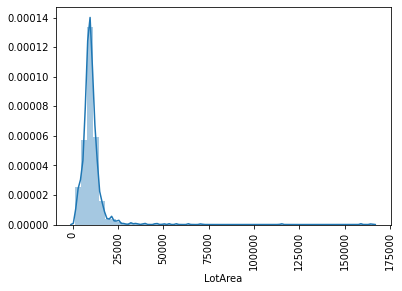

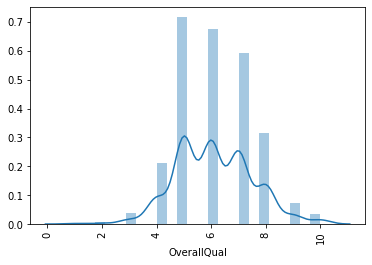

...

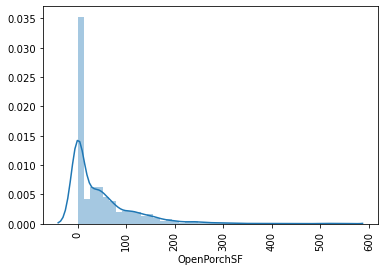

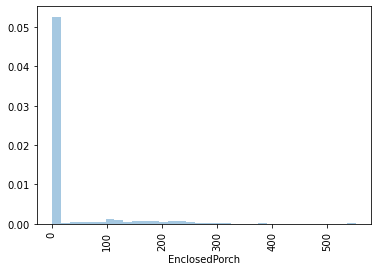

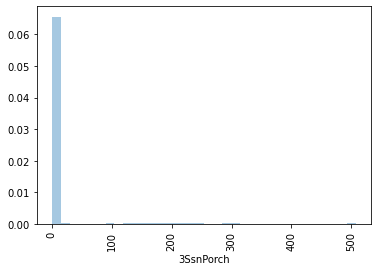

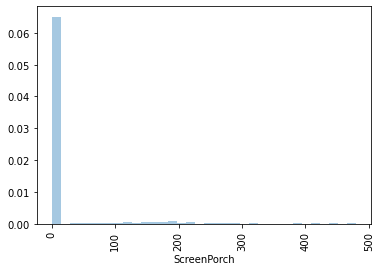

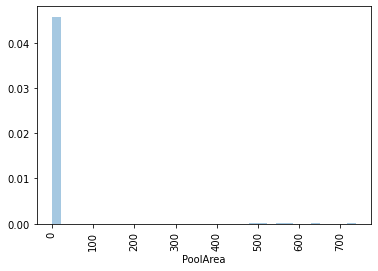

ValueError: could not convert string to float: 'Ex'

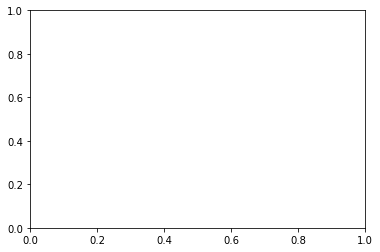

In [24]:
for i in Test.describe().columns:
    sns.distplot(Train[i])
    plt.xticks(rotation=90)
    plt.show()

In [25]:
Train.MSZoning.value_counts()

RL         928
RM         163
FV          52
RH          16
C (all)      9
Name: MSZoning, dtype: int64

In [26]:
Train.Street.value_counts()

Pave    1164
Grvl       4
Name: Street, dtype: int64

In [27]:
Train.Alley.value_counts()

Grvl    41
Pave    36
Name: Alley, dtype: int64

In [28]:
Train.LotShape.value_counts()

Reg    740
IR1    390
IR2     32
IR3      6
Name: LotShape, dtype: int64

In [29]:
Train.LandContour.value_counts()

Lvl    1046
Bnk      50
HLS      42
Low      30
Name: LandContour, dtype: int64

In [30]:
Train.Utilities.value_counts()

AllPub    1168
Name: Utilities, dtype: int64

In [31]:
Train.Fence.value_counts()

MnPrv    129
GdPrv     51
GdWo      47
MnWw      10
Name: Fence, dtype: int64

In [32]:
Train.PoolQC.value_counts()

Gd    3
Ex    2
Fa    2
Name: PoolQC, dtype: int64

In [33]:
Train.PoolArea.value_counts()

0      1161
738       1
648       1
576       1
555       1
519       1
512       1
480       1
Name: PoolArea, dtype: int64

In [34]:
Train.YrSold.value_counts()

2007    264
2009    260
2006    254
2008    248
2010    142
Name: YrSold, dtype: int64

In [35]:
Train.SaleCondition.value_counts()

Normal     945
Partial    108
Abnorml     81
Family      18
Alloca      12
AdjLand      4
Name: SaleCondition, dtype: int64

In [36]:
Train.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1168.000000,1168.000000,954.00000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1161.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1104.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000
mean,724.136130,56.767979,70.98847,10484.749144,6.104452,5.595890,1970.930651,1984.758562,102.310078,444.726027,46.647260,569.721747,1061.095034,1169.860445,348.826199,6.380137,1525.066781,0.425514,0.055651,1.562500,0.388699,2.884418,1.045377,6.542808,0.617295,1978.193841,1.776541,476.860445,96.206336,46.559932,23.015411,3.639555,15.051370,3.448630,47.315068,6.344178,2007.804795,181477.005993
std,416.159877,41.940650,24.82875,8957.442311,1.390153,1.124343,30.145255,20.785185,182.595606,462.664785,163.520016,449.375525,442.272249,391.161983,439.696370,50.892844,528.042957,0.521615,0.236699,0.551882,0.504929,0.817229,0.216292,1.598484,0.650575,24.890704,0.745554,214.466769,126.158988,66.381023,63.191089,29.088867,55.080816,44.896939,543.264432,2.686352,1.329738,79105.586863
min,1.000000,20.000000,21.00000,1300.000000,1.000000,1.000000,1875.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,360.500000,20.000000,60.00000,7621.500000,5.000000,5.000000,1954.000000,1966.000000,0.000000,0.000000,0.000000,216.000000,799.000000,892.000000,0.000000,0.000000,1143.250000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1961.000000,1.000000,338.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,130375.000000
50%,714.500000,50.000000,70.00000,9522.500000,6.000000,5.000000,1972.000000,1993.000000,0.000000,385.500000,0.000000,474.000000,1005.500000,1096.500000,0.000000,0.000000,1468.500000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,480.000000,0.000000,24.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163995.000000
75%,1079.500000,70.000000,80.00000,11515.500000,7.000000,6.000000,2000.000000,2004.000000,160.000000,714.500000,0.000000,816.000000,1291.500000,1392.000000,729.000000,0.000000,1795.000000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2002.000000,2.000000,576.000000,171.000000,70.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,215000.000000
max,1460.000000,190.000000,313.00000,164660.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,3.000000,2.000000,3.000000,2.000000,8.000000,3.000000,14.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


In [37]:
Train

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,RL,NaN,4928,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NPkVill,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,TA,Attchd,1977.0,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,NaN,NaN,NaN,0,2,2007,WD,Normal,128000
1,889,20,RL,95.0,15865,Pave,NaN,IR1,Lvl,AllPub,Inside,Mod,NAmes,Norm,Norm,1Fam,1Story,8,6,1970,1970,Flat,Tar&Grv,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,PConc,TA,Gd,Gd,ALQ,351,Rec,823,1043,2217,GasA,Ex,Y,SBrkr,2217,0,0,2217,1,0,2,0,4,1,Gd,8,Typ,1,TA,Attchd,1970.0,Unf,2,621,TA,TA,Y,81,207,0,0,224,0,NaN,NaN,NaN,0,10,2007,WD,Normal,268000
2,793,60,RL,92.0,9920,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,TA,Attchd,1997.0,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,NaN,NaN,NaN,0,6,2007,WD,Normal,269790
3,110,20,RL,105.0,11751,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.0,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,TA,Attchd,1977.0,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,NaN,MnPrv,NaN,0,1,2010,COD,Normal,190000
4,422,20,RL,NaN,16635,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.0,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,TA,Attchd,1977.0,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,NaN,NaN,NaN,0,6,2009,WD,Normal,215000
5,1197,60,RL,58.0,14054,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,7,5,2006,2006,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,Unf,0,Unf,0,879,879,GasA,Ex,Y,SBrkr,879,984,0,1863,0,0,2,1,4,1,Gd,9,Typ,1,Gd,BuiltIn,2006.0,Fin,3,660,TA,TA,Y,100,17,0,0,0,0,NaN,NaN,NaN,0,11,2006,New,Partial,219210
6,561,20,RL,NaN,11341,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Sawyer,Norm,Norm,1Fam,1Story,5,6,1957,1996,Hip,CompShg,Wd Sdng,Wd Sdng,BrkFace,180.0,TA,TA,CBlock,Gd,TA,No,ALQ,1302,Unf,0,90,1392,GasA,TA,Y,SBrkr,1392,0,0,1392,1,0,1,1,3,1,TA,5,Mod,1,Gd,Detchd,1957.0,Unf,2,528,TA,TA,Y,0,0,0,0,95,0,NaN,NaN,NaN,0,5,2010,WD,Normal,121500
7,1041,20,RL,88.0,13125,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Sawyer,Norm,Norm,1Fam,1Story,5,4,1957,2000,Gable,CompShg,Wd Sdng,Wd Sdng,BrkCmn,67.0,TA,TA,CBlock,TA,TA,No,Rec,168,BLQ,682,284,1134,GasA,Ex,Y,SBrkr,1803,0,0,1803,1,0,2,0,3,1,TA,8,Maj1,1,TA,Attchd,1957.0,RFn,2,484,TA,TA,Y,0,0,0,0,0,0,NaN,GdPrv,NaN,0,1,2006,WD,Normal,155000
8,503,20,RL,70.0,9170,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Feedr,Norm,1Fam,1Story,5,7,1965,1965,Hip,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,TA,TA,No,ALQ,698,GLQ,96,420,1214,GasA,Ex,Y,SBrkr,1214,0,0,1214,1,0,1,0,2,1,TA,6,Typ,0,NaN,Detchd,1965.0,Unf,2,461,Fa,Fa,Y,0,0,184,0,0,0,NaN,GdPrv,Shed,400,4,2007,WD,Normal,140000
9,576,50,RL,80.0,8480,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1.5Fin,5,5,1947,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,442,Unf,0,390,832,Gas

# --------------------------------------------- Visualization-------------------------------------------------

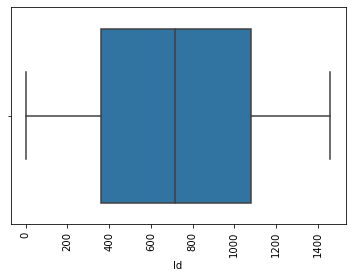

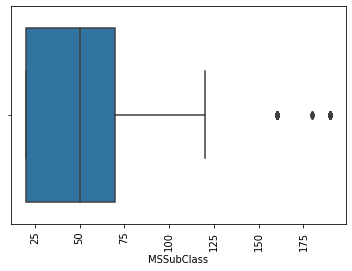

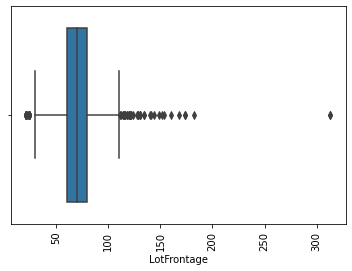

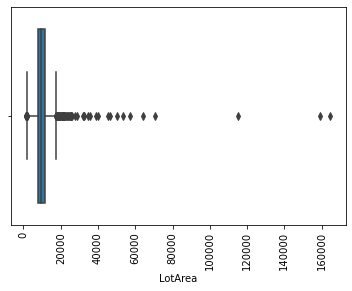

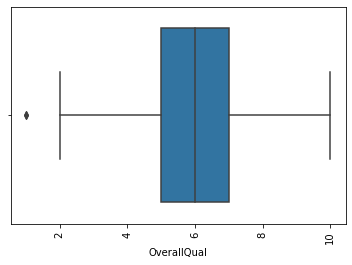

...

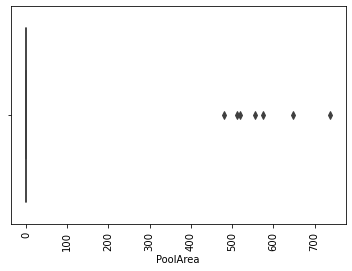

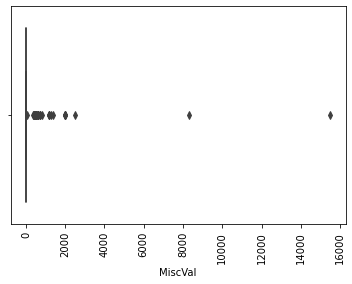

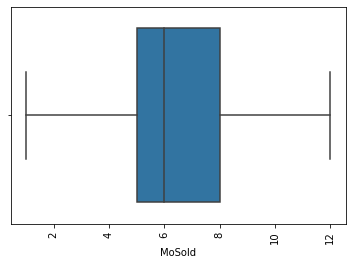

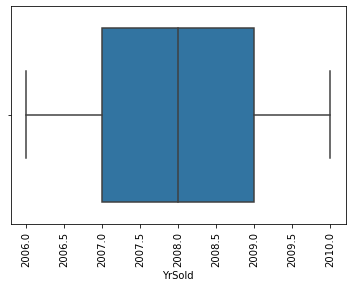

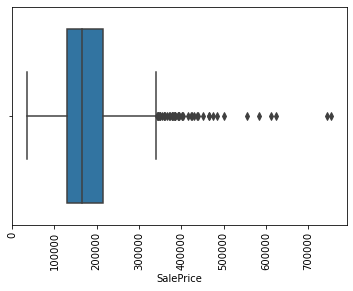

In [38]:
for i in Train.describe().columns:
    # Train[i].plot.box()
    sns.boxplot(Train[i])
    plt.xticks(rotation=90)
    plt.show()

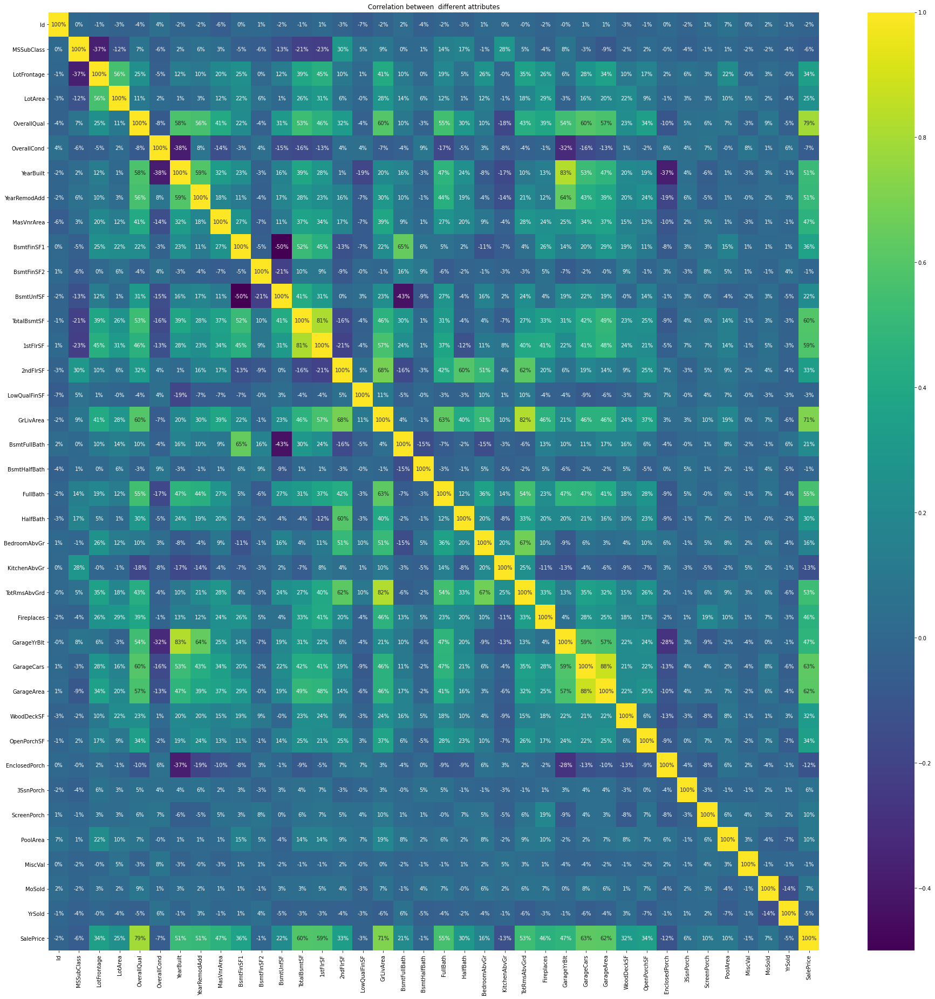

In [39]:
plt.figure(figsize=(32,32))
sns.heatmap(Train.corr(),annot=True,fmt='.0%',cmap='viridis')
plt.title('Correlation between  different attributes')

plt.show()

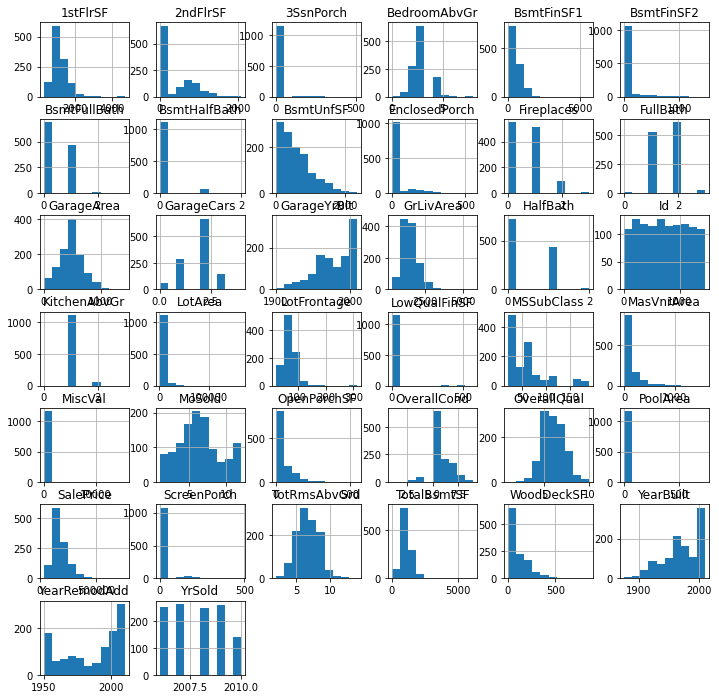

In [40]:
Train.hist(figsize=(12,12));

In [41]:
#sns.pairplot(Train)

(array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
        35, 36, 37, 38]),
 <a list of 38 Text major ticklabel objects>)

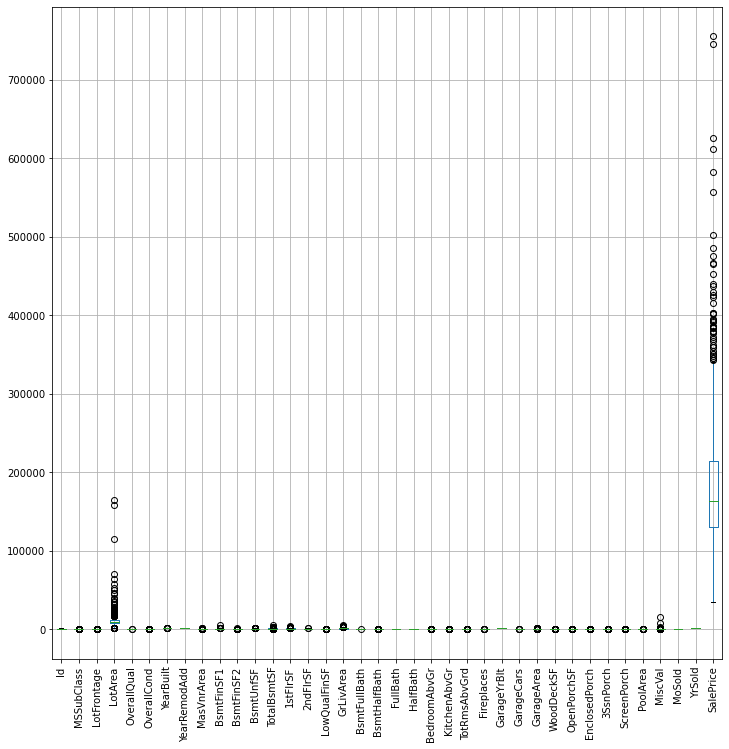

In [42]:
Train.boxplot(figsize=(12,12));
plt.xticks(rotation=90)

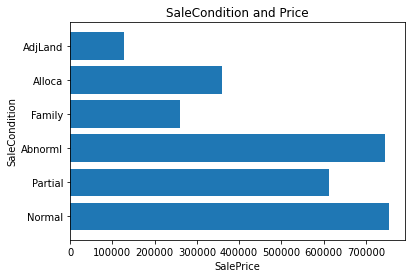

In [43]:
plt.barh(Train['SaleCondition'],Train['SalePrice'])
plt.title('SaleCondition and Price')
plt.xlabel('SalePrice')
plt.ylabel('SaleCondition')
plt.show()

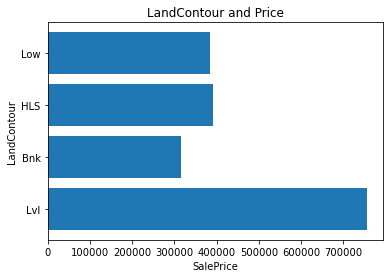

In [44]:
plt.barh(Train['LandContour'],Train['SalePrice'])
plt.title('LandContour and Price')
plt.xlabel('SalePrice')
plt.ylabel('LandContour')
plt.show()

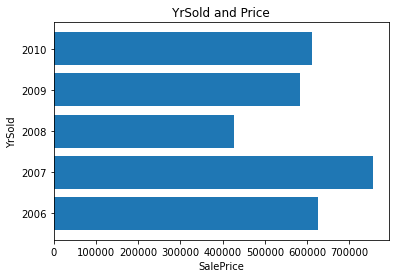

In [45]:
plt.barh(Train['YrSold'],Train['SalePrice'])
plt.title('YrSold and Price')
plt.xlabel('SalePrice')
plt.ylabel('YrSold')
plt.show()

(array([0, 1]), <a list of 2 Text major ticklabel objects>)

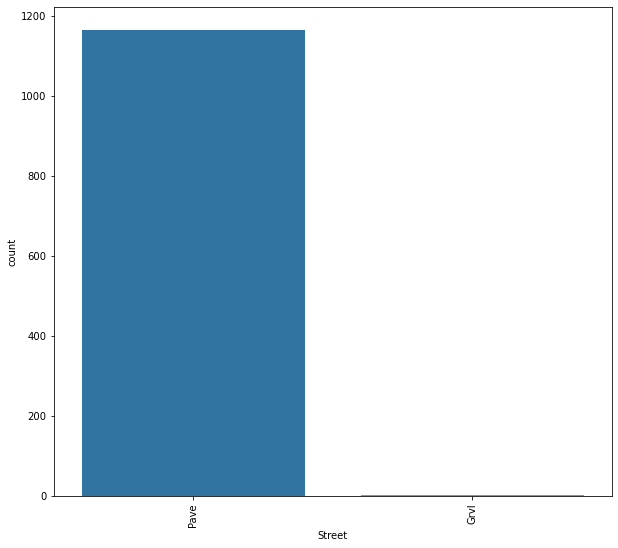

In [46]:
plt.figure(figsize=(10,9))
sns.countplot(Train.Street)
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4]), <a list of 5 Text major ticklabel objects>)

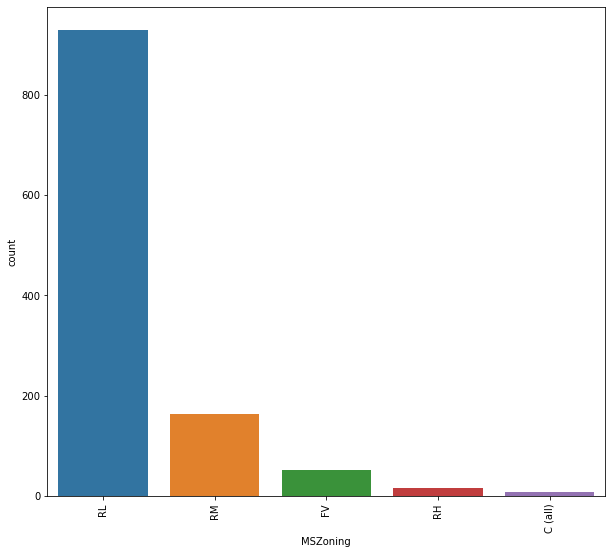

In [47]:
plt.figure(figsize=(10,9))
sns.countplot(Train.MSZoning)
plt.xticks(rotation=90)

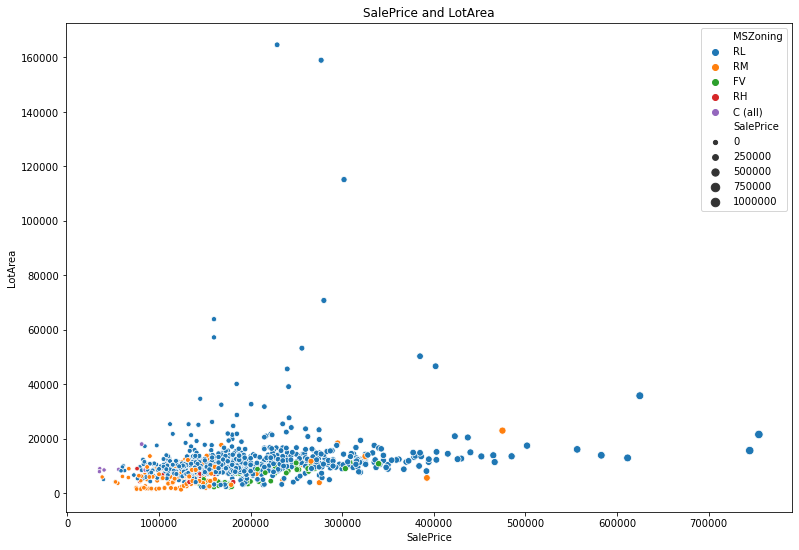

In [48]:
plt.figure(figsize=(13,9))
plt.xlabel('SalePrice')
plt.ylabel('LotArea')
plt.title('SalePrice and LotArea')
sns.scatterplot(x='SalePrice',y='LotArea',hue='MSZoning',size='SalePrice',data=Train)

Text(0.5, 1.0, 'House Price vs YearSold')

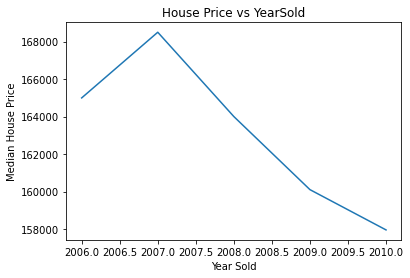

In [49]:
Train.groupby('YrSold')['SalePrice'].median().plot()
plt.xlabel('Year Sold')
plt.ylabel('Median House Price')
plt.title("House Price vs YearSold")

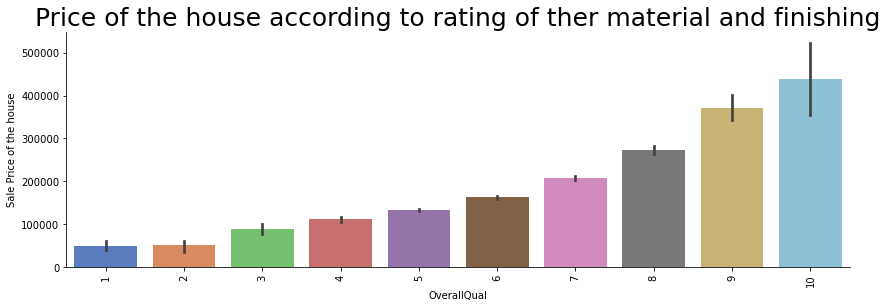

In [50]:
#Factor plot of OverallQual vs SalePrice
sns.factorplot(x="OverallQual",y="SalePrice",data=Train,kind="bar",size = 4,palette = "muted",aspect=3)
plt.title('Price of the house according to rating of ther material and finishing',fontsize=25)
plt.ylabel("Sale Price of the house")
plt.xticks(rotation=90)
plt.show()

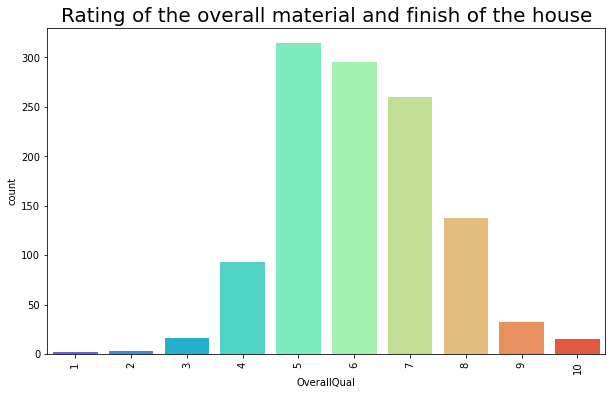

5     314
6     295
7     260
8     138
4      93
9      32
3      16
10     15
2       3
1       2
Name: OverallQual, dtype: int64


In [51]:
plt.figure(figsize=(10,6))
sns.countplot(Train['OverallQual'],palette= 'rainbow')
plt.title("Rating of the overall material and finish of the house",fontsize=20)
plt.xticks(rotation=90)
plt.show()

print(Train.OverallQual.value_counts())

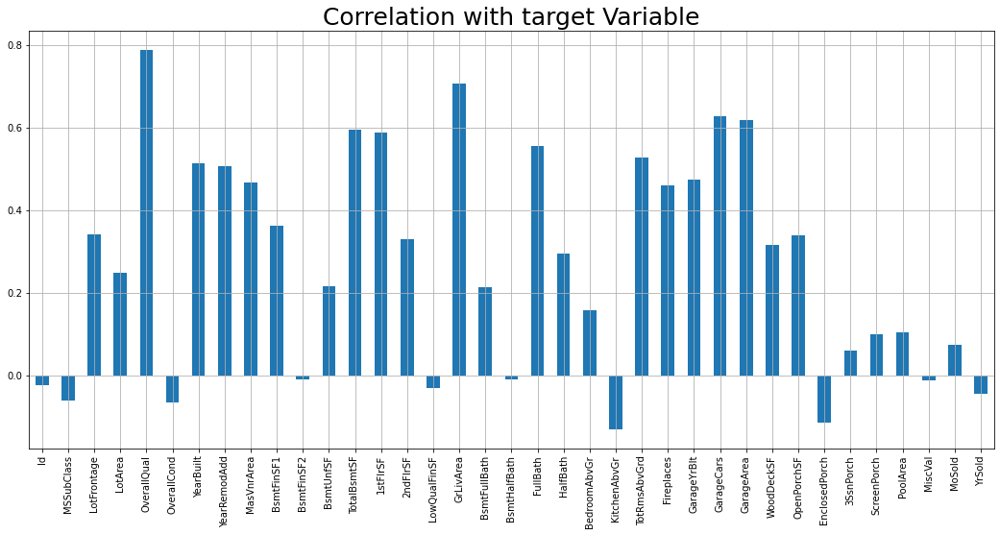

In [52]:
#Checking the correlation with target variable that is SalePrice
plt.figure(figsize=(18,8))
Train.drop('SalePrice', axis=1).corrwith(Train['SalePrice']).plot(kind='bar',grid=True )
plt.xticks(rotation=90)
plt.title("Correlation with target Variable",fontsize=25)
plt.show()

In [53]:
df=pd.concat([Train,Test],ignore_index=True)
df

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,RL,NaN,4928,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NPkVill,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,TA,Attchd,1977.0,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,NaN,NaN,NaN,0,2,2007,WD,Normal,128000.0
1,889,20,RL,95.0,15865,Pave,NaN,IR1,Lvl,AllPub,Inside,Mod,NAmes,Norm,Norm,1Fam,1Story,8,6,1970,1970,Flat,Tar&Grv,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,PConc,TA,Gd,Gd,ALQ,351,Rec,823,1043,2217,GasA,Ex,Y,SBrkr,2217,0,0,2217,1,0,2,0,4,1,Gd,8,Typ,1,TA,Attchd,1970.0,Unf,2,621,TA,TA,Y,81,207,0,0,224,0,NaN,NaN,NaN,0,10,2007,WD,Normal,268000.0
2,793,60,RL,92.0,9920,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,TA,Attchd,1997.0,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,NaN,NaN,NaN,0,6,2007,WD,Normal,269790.0
3,110,20,RL,105.0,11751,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.0,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,TA,Attchd,1977.0,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,NaN,MnPrv,NaN,0,1,2010,COD,Normal,190000.0
4,422,20,RL,NaN,16635,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.0,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,TA,Attchd,1977.0,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,NaN,NaN,NaN,0,6,2009,WD,Normal,215000.0
5,1197,60,RL,58.0,14054,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,7,5,2006,2006,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,Unf,0,Unf,0,879,879,GasA,Ex,Y,SBrkr,879,984,0,1863,0,0,2,1,4,1,Gd,9,Typ,1,Gd,BuiltIn,2006.0,Fin,3,660,TA,TA,Y,100,17,0,0,0,0,NaN,NaN,NaN,0,11,2006,New,Partial,219210.0
6,561,20,RL,NaN,11341,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Sawyer,Norm,Norm,1Fam,1Story,5,6,1957,1996,Hip,CompShg,Wd Sdng,Wd Sdng,BrkFace,180.0,TA,TA,CBlock,Gd,TA,No,ALQ,1302,Unf,0,90,1392,GasA,TA,Y,SBrkr,1392,0,0,1392,1,0,1,1,3,1,TA,5,Mod,1,Gd,Detchd,1957.0,Unf,2,528,TA,TA,Y,0,0,0,0,95,0,NaN,NaN,NaN,0,5,2010,WD,Normal,121500.0
7,1041,20,RL,88.0,13125,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Sawyer,Norm,Norm,1Fam,1Story,5,4,1957,2000,Gable,CompShg,Wd Sdng,Wd Sdng,BrkCmn,67.0,TA,TA,CBlock,TA,TA,No,Rec,168,BLQ,682,284,1134,GasA,Ex,Y,SBrkr,1803,0,0,1803,1,0,2,0,3,1,TA,8,Maj1,1,TA,Attchd,1957.0,RFn,2,484,TA,TA,Y,0,0,0,0,0,0,NaN,GdPrv,NaN,0,1,2006,WD,Normal,155000.0
8,503,20,RL,70.0,9170,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Feedr,Norm,1Fam,1Story,5,7,1965,1965,Hip,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,TA,TA,No,ALQ,698,GLQ,96,420,1214,GasA,Ex,Y,SBrkr,1214,0,0,1214,1,0,1,0,2,1,TA,6,Typ,0,NaN,Detchd,1965.0,Unf,2,461,Fa,Fa,Y,0,0,184,0,0,0,NaN,GdPrv,Shed,400,4,2007,WD,Normal,140000.0
9,576,50,RL,80.0,8480,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1.5Fin,5,5,1947,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,442

In [54]:
#Seeing the NaN values in ratio
print('\nPercentage of missing values in each column:')
(df.isnull().sum() / df.shape[0]).sort_values(ascending=False).head(20)


Percentage of missing values in each column:


PoolQC          0.995205
MiscFeature     0.963014
Alley           0.937671
Fence           0.807534
FireplaceQu     0.472603
SalePrice       0.200000
LotFrontage     0.177397
GarageQual      0.055479
GarageCond      0.055479
GarageType      0.055479
GarageYrBlt     0.055479
GarageFinish    0.055479
BsmtFinType2    0.026027
BsmtExposure    0.026027
BsmtQual        0.025342
BsmtCond        0.025342
BsmtFinType1    0.025342
MasVnrArea      0.005479
MasVnrType      0.005479
Electrical      0.000685
dtype: float64

In [55]:
# Removing columns having more than 30% missing values
df = df.drop('PoolQC', axis=1)
df = df.drop('MiscFeature', axis=1)
df = df.drop('Alley', axis=1)
df = df.drop('Fence',axis=1)
df = df.drop('FireplaceQu',axis=1)

In [56]:
df.shape

(1460, 76)

In [57]:
#Number of missing values and their percentage in each row
print(pd.DataFrame.from_dict({'Rows' : df.isnull().any(axis = 1), 
                              'missing values' : df.isnull().sum(axis = 1), 
                              'Percentage of missing values' : round(100*df.isnull().sum(axis = 1)/df.shape[1])})
     )

       Rows  missing values  Percentage of missing values
0      True               1                           1.0
1     False               0                           0.0
2     False               0                           0.0
3     False               0                           0.0
4      True               1                           1.0
5     False               0                           0.0
6      True               1                           1.0
7     False               0                           0.0
8     False               0                           0.0
9     False               0                           0.0
10    False               0                           0.0
11    False               0                           0.0
12    False               0                           0.0
13    False               0                           0.0
14    False               0                           0.0
15    False               0                           0.0
16     True   

In [58]:
#Number and percentage of rows having more than 1 missing values
# count the number of rows having > 1 missing values
print("Number of rows having more than 5 missing values : ", len(df[df.isnull().sum(axis=1) > 1].index))
print("Number of rows having more than 5 missing values : ", 100*(len(df[df.isnull().sum(axis=1) > 1].index) / len(df.index)))

Number of rows having more than 5 missing values :  164
Number of rows having more than 5 missing values :  11.232876712328768


In [59]:
# Retaining the rows having <= 1 NaNs
df = df[df.isnull().sum(axis=1) <= 1]

In [60]:
#Percentage of missing values in each column
print(round(100*(df.isnull().sum()/len(df.index)), 2))

Id                0.00
MSSubClass        0.00
MSZoning          0.00
LotFrontage      15.43
LotArea           0.00
Street            0.00
LotShape          0.00
LandContour       0.00
Utilities         0.00
LotConfig         0.00
LandSlope         0.00
Neighborhood      0.00
Condition1        0.00
Condition2        0.00
BldgType          0.00
HouseStyle        0.00
OverallQual       0.00
OverallCond       0.00
YearBuilt         0.00
YearRemodAdd      0.00
RoofStyle         0.00
RoofMatl          0.00
Exterior1st       0.00
Exterior2nd       0.00
MasVnrType        0.00
MasVnrArea        0.00
ExterQual         0.00
ExterCond         0.00
Foundation        0.00
BsmtQual          0.00
BsmtCond          0.00
BsmtExposure      0.08
BsmtFinType1      0.00
BsmtFinSF1        0.00
BsmtFinType2      0.08
BsmtFinSF2        0.00
BsmtUnfSF         0.00
TotalBsmtSF       0.00
Heating           0.00
HeatingQC         0.00
CentralAir        0.00
Electrical        0.00
1stFlrSF          0.00
2ndFlrSF   

In [61]:
df['LotFrontage'].describe(percentiles = [0.9, 0.95, 0.99])

count    1096.000000
mean       70.767336
std        24.490864
min        21.000000
50%        70.000000
90%        96.000000
95%       108.000000
99%       141.150000
max       313.000000
Name: LotFrontage, dtype: float64

In [62]:
df['LotFrontage'].fillna(df['LotFrontage'].mean(),inplace=True)

In [63]:
df.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1296.000000,1073.000000
mean,729.057870,55.972222,70.767336,10664.395062,6.224537,5.593364,1972.845679,1985.696759,108.885802,461.688272,49.297068,588.889660,1099.875000,1178.012346,355.383488,4.358796,1537.754630,0.439043,0.057099,1.576389,0.398920,2.868827,1.030864,6.564043,0.640432,1978.502315,1.873457,501.793210,97.895062,47.469136,21.822531,3.702160,16.368056,3.108025,43.436728,6.347994,2007.799383,187308.009320
std,421.555409,41.264988,22.520410,10376.097970,1.333170,1.072184,29.842096,20.457958,185.165023,460.258026,166.703345,442.146302,411.091396,388.179720,439.705574,41.360643,521.290781,0.516286,0.235424,0.546267,0.503853,0.772950,0.177423,1.578985,0.644814,25.027521,0.639285,187.939809,126.924134,65.046362,61.603347,30.703829,57.537065,42.632803,515.726791,2.709636,1.332643,78350.055485
min,1.000000,20.000000,21.000000,1300.000000,2.000000,2.000000,1880.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,105.000000,438.000000,0.000000,0.000000,438.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,3.000000,0.000000,1900.000000,1.000000,160.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,35311.000000
25%,361.750000,20.000000,60.000000,7737.000000,5.000000,5.000000,1955.000000,1968.000000,0.000000,0.000000,0.000000,251.750000,824.750000,894.000000,0.000000,0.000000,1158.000000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,6.000000,0.000000,1961.000000,1.000000,371.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,135000.000000
50%,724.500000,50.000000,70.767336,9590.500000,6.000000,5.000000,1976.000000,1995.000000,0.000000,406.500000,0.000000,499.000000,1026.000000,1101.500000,0.000000,0.000000,1479.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,484.000000,0.000000,28.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,169900.000000
75%,1095.250000,70.000000,80.000000,11700.000000,7.000000,6.000000,2002.000000,2004.000000,172.500000,733.250000,0.000000,832.000000,1333.250000,1422.000000,739.000000,0.000000,1792.000000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2002.000000,2.000000,588.000000,171.250000,70.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,222000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,2.000000,2.000000,3.000000,2.000000,6.000000,3.000000,12.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


MasVnrArea
1stFlrSF
2ndFlrSF
LowQualFinSF
GrLivArea
OpenPorchSF

In [64]:
df

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,RL,70.767336,4928,Pave,IR1,Lvl,AllPub,Inside,Gtl,NPkVill,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,Attchd,1977.0,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,0,2,2007,WD,Normal,128000.0
1,889,20,RL,95.000000,15865,Pave,IR1,Lvl,AllPub,Inside,Mod,NAmes,Norm,Norm,1Fam,1Story,8,6,1970,1970,Flat,Tar&Grv,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,PConc,TA,Gd,Gd,ALQ,351,Rec,823,1043,2217,GasA,Ex,Y,SBrkr,2217,0,0,2217,1,0,2,0,4,1,Gd,8,Typ,1,Attchd,1970.0,Unf,2,621,TA,TA,Y,81,207,0,0,224,0,0,10,2007,WD,Normal,268000.0
2,793,60,RL,92.000000,9920,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,Attchd,1997.0,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,0,6,2007,WD,Normal,269790.0
3,110,20,RL,105.000000,11751,Pave,IR1,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.0,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,Attchd,1977.0,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,0,1,2010,COD,Normal,190000.0
4,422,20,RL,70.767336,16635,Pave,IR1,Lvl,AllPub,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.0,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,Attchd,1977.0,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,0,6,2009,WD,Normal,215000.0
5,1197,60,RL,58.000000,14054,Pave,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,7,5,2006,2006,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,Unf,0,Unf,0,879,879,GasA,Ex,Y,SBrkr,879,984,0,1863,0,0,2,1,4,1,Gd,9,Typ,1,BuiltIn,2006.0,Fin,3,660,TA,TA,Y,100,17,0,0,0,0,0,11,2006,New,Partial,219210.0
6,561,20,RL,70.767336,11341,Pave,IR1,Lvl,AllPub,Inside,Gtl,Sawyer,Norm,Norm,1Fam,1Story,5,6,1957,1996,Hip,CompShg,Wd Sdng,Wd Sdng,BrkFace,180.0,TA,TA,CBlock,Gd,TA,No,ALQ,1302,Unf,0,90,1392,GasA,TA,Y,SBrkr,1392,0,0,1392,1,0,1,1,3,1,TA,5,Mod,1,Detchd,1957.0,Unf,2,528,TA,TA,Y,0,0,0,0,95,0,0,5,2010,WD,Normal,121500.0
7,1041,20,RL,88.000000,13125,Pave,Reg,Lvl,AllPub,Corner,Gtl,Sawyer,Norm,Norm,1Fam,1Story,5,4,1957,2000,Gable,CompShg,Wd Sdng,Wd Sdng,BrkCmn,67.0,TA,TA,CBlock,TA,TA,No,Rec,168,BLQ,682,284,1134,GasA,Ex,Y,SBrkr,1803,0,0,1803,1,0,2,0,3,1,TA,8,Maj1,1,Attchd,1957.0,RFn,2,484,TA,TA,Y,0,0,0,0,0,0,0,1,2006,WD,Normal,155000.0
8,503,20,RL,70.000000,9170,Pave,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Feedr,Norm,1Fam,1Story,5,7,1965,1965,Hip,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,TA,TA,No,ALQ,698,GLQ,96,420,1214,GasA,Ex,Y,SBrkr,1214,0,0,1214,1,0,1,0,2,1,TA,6,Typ,0,Detchd,1965.0,Unf,2,461,Fa,Fa,Y,0,0,184,0,0,0,400,4,2007,WD,Normal,140000.0
9,576,50,RL,80.000000,8480,Pave,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1.5Fin,5,5,1947,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,442,Unf,0,390,832,GasA,TA,Y,SBrkr,832,384,0,1216,0,0,1,0,2,1,TA,6,Typ,0,Detchd,1947.0,Unf,1,336,TA,TA,Y,158,0,102,0,0,0,0,10,2008,COD,Abnorml,118500.0


In [65]:
df['LotFrontage'] = df['LotFrontage'].astype(int)

In [66]:
#Removing the Outliers of LotFrontage
threshold=3
df = df[ np.abs(df['LotFrontage'] - df['LotFrontage'].mean()) / df['LotFrontage'].std() < threshold]

In [67]:
df['LotFrontage'].describe()

count    1283.000000
mean       69.525331
std        18.784846
min        21.000000
25%        60.000000
50%        70.000000
75%        80.000000
max       137.000000
Name: LotFrontage, dtype: float64

In [68]:
df.describe(include=['object']).transpose()

,count,unique,top,freq
MSZoning,1283,5,RL,1017
Street,1283,2,Pave,1278
LotShape,1283,4,Reg,816
LandContour,1283,4,Lvl,1160
Utilities,1283,1,AllPub,1283
LotConfig,1283,5,Inside,931
LandSlope,1283,3,Gtl,1219
Neighborhood,1283,25,NAmes,200
Condition1,1283,9,Norm,1113
Condition2,1283,8,Norm,1269


In [69]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,RL,70,4928,Pave,IR1,Lvl,AllPub,Inside,Gtl,NPkVill,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,Attchd,1977.0,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,0,2,2007,WD,Normal,128000.0
1,889,20,RL,95,15865,Pave,IR1,Lvl,AllPub,Inside,Mod,NAmes,Norm,Norm,1Fam,1Story,8,6,1970,1970,Flat,Tar&Grv,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,PConc,TA,Gd,Gd,ALQ,351,Rec,823,1043,2217,GasA,Ex,Y,SBrkr,2217,0,0,2217,1,0,2,0,4,1,Gd,8,Typ,1,Attchd,1970.0,Unf,2,621,TA,TA,Y,81,207,0,0,224,0,0,10,2007,WD,Normal,268000.0
2,793,60,RL,92,9920,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,Attchd,1997.0,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,0,6,2007,WD,Normal,269790.0
3,110,20,RL,105,11751,Pave,IR1,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.0,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,Attchd,1977.0,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,0,1,2010,COD,Normal,190000.0
4,422,20,RL,70,16635,Pave,IR1,Lvl,AllPub,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.0,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,Attchd,1977.0,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,0,6,2009,WD,Normal,215000.0


In [70]:
df_corelation = df.corr()
df_corelation

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
Id,1.000000,0.014491,-0.032663,-0.033272,-0.055135,0.013719,-0.030984,-0.035767,-0.059912,-0.022619,0.002581,-0.012469,-0.038776,-0.008856,-0.008712,-0.040550,-0.017453,0.012452,-0.034726,-0.007677,-0.018229,0.043840,0.015144,0.013889,-0.023097,-0.013417,0.000407,-0.000839,-0.042215,-0.012920,0.021857,-0.044045,0.003545,0.061658,0.000841,0.014916,0.008256,-0.037040
MSSubClass,0.014491,1.000000,-0.423796,-0.140317,0.050758,-0.098448,0.049265,0.028996,0.023881,-0.074536,-0.072938,-0.143300,-0.280628,-0.263620,0.309185,0.017749,0.074042,-0.010283,0.003725,0.123009,0.192000,-0.057326,0.243755,0.029761,-0.025172,0.075436,0.005287,-0.069651,-0.003422,-0.000293,-0.026534,-0.041949,-0.021924,0.005451,-0.020929,-0.017274,-0.020181,-0.057568
LotFrontage,-0.032663,-0.423796,1.000000,0.248285,0.217963,-0.043490,0.114486,0.063326,0.197261,0.134204,0.047482,0.156332,0.352002,0.381607,0.041206,-0.023034,0.318881,0.056797,-0.004478,0.175799,0.037543,0.264361,0.019560,0.317388,0.213590,0.078800,0.296514,0.342280,0.090389,0.133693,-0.014244,0.084764,0.056383,0.017860,0.003992,0.016224,0.000708,0.338673
LotArea,-0.033272,-0.140317,0.248285,1.000000,0.086049,0.017021,-0.001442,0.018399,0.115767,0.176032,0.057709,0.005703,0.230185,0.274933,0.059021,0.003187,0.256885,0.124202,0.048276,0.119890,0.011415,0.131942,-0.009014,0.180029,0.259679,-0.018285,0.160348,0.183715,0.218756,0.081025,-0.024468,0.028500,0.056651,0.025401,0.053688,0.014131,-0.030665,0.242794
OverallQual,-0.055135,0.050758,0.217963,0.086049,1.000000,-0.163509,0.578874,0.552373,0.411695,0.179251,-0.081715,0.303097,0.516084,0.477919,0.269155,-0.027523,0.589011,0.079577,-0.066815,0.579519,0.251067,0.071076,-0.137255,0.434854,0.373793,0.552059,0.591711,0.527487,0.225412,0.316019,-0.136819,0.027427,0.046041,-0.000248,-0.029385,0.067738,-0.015557,0.787848
OverallCond,0.013719,-0.098448,-0.043490,0.017021,-0.163509,1.000000,-0.419584,0.032707,-0.154994,-0.046965,0.028662,-0.161479,-0.226585,-0.148576,0.009060,0.055801,-0.098526,-0.071182,0.121949,-0.207406,-0.080268,0.025126,-0.072712,-0.070738,-0.031028,-0.340076,-0.253501,-0.211553,-0.018193,-0.062650,0.081724,0.024411,0.063142,0.025407,0.077085,-0.010435,0.050964,-0.098127
YearBuilt,-0.030984,0.049265,0.114486,-0.001442,0.578874,-0.419584,1.000000,0.620808,0.312518,0.233229,-0.060161,0.149992,0.410020,0.279050,0.002146,-0.153264,0.197857,0.184104,-0.044808,0.492947,0.229310,-0.078653,-0.177103,0.104313,0.112404,0.823154,0.532383,0.458250,0.213691,0.223387,-0.388330,0.030182,-0.072558,0.000619,-0.033316,0.000086,-0.010337,0.507172
YearRemodAdd,-0.035767,0.028996,0.063326,0.018399,0.552373,0.032707,0.620808,1.000000,0.177957,0.099033,-0.076708,0.176844,0.282314,0.251598,0.112778,-0.069012,0.280514,0.098038,-0.019322,0.465809,0.168575,-0.076082,-0.155940,0.173648,0.089342,0.646846,0.464955,0.394757,0.204950,0.233717,-0.233383,0.040166,-0.049144,-0.016126,-0.000153,0.011425,0.037228,0.511416
MasVnrArea,-0.059912,0.023881,0.197261,0.115767,0.411695,-0.154994,0.312518,0.177957,1.000000,0.251175,-0.084833,0.110846,0.374552,0.339565,0.169174,-0.060294,0.396007,0.085655,0.005741,0.278537,0.190138,0.108669,-0.006105,0.293398,0.229208,0.256839,0.370018,0.369757,0.160242,0.114738,-0.120744,0.016608,0.050412,-0.013387,-0.029671,0.001459,-0.001390,0.475840
BsmtFinSF1,-0.022619,-0.074536,0.134204,0.176032,0.179251,-0.046965,0.233229,0.099033,0.251175,1.000000,-0.064261,-0.576499,0.437252,0.400348,-0.182451,-0.065818,0.134574,0.649504,0.050394,0.032210,-0.029718,-0.129562,-0.034631,0.019843,0.223539,0.150775,0.202683,0.253094,0.197697,0.077779,-0.120655,0.

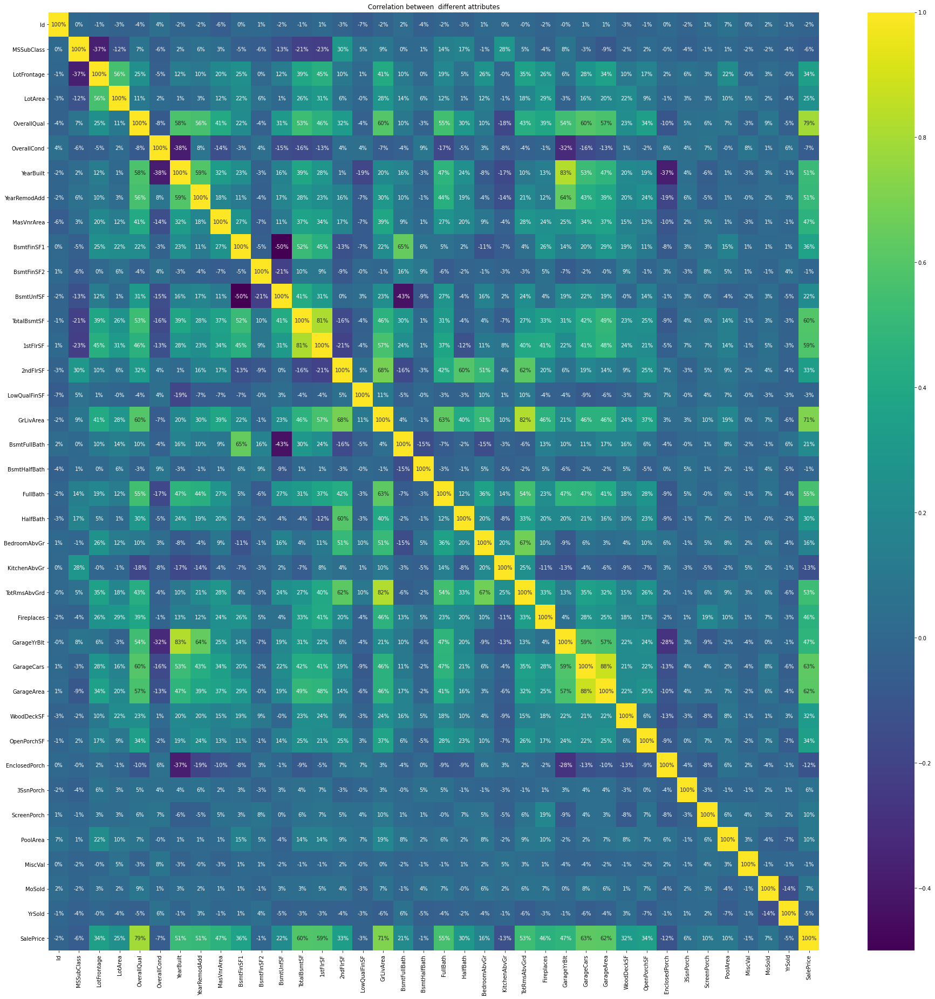

In [71]:
plt.figure(figsize=(32,32))
sns.heatmap(Train.corr(),annot=True,fmt='.0%',cmap='viridis')
plt.title('Correlation between  different attributes')

plt.show()

In [72]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,RL,70,4928,Pave,IR1,Lvl,AllPub,Inside,Gtl,NPkVill,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,Attchd,1977.0,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,0,2,2007,WD,Normal,128000.0
1,889,20,RL,95,15865,Pave,IR1,Lvl,AllPub,Inside,Mod,NAmes,Norm,Norm,1Fam,1Story,8,6,1970,1970,Flat,Tar&Grv,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,PConc,TA,Gd,Gd,ALQ,351,Rec,823,1043,2217,GasA,Ex,Y,SBrkr,2217,0,0,2217,1,0,2,0,4,1,Gd,8,Typ,1,Attchd,1970.0,Unf,2,621,TA,TA,Y,81,207,0,0,224,0,0,10,2007,WD,Normal,268000.0
2,793,60,RL,92,9920,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,Attchd,1997.0,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,0,6,2007,WD,Normal,269790.0
3,110,20,RL,105,11751,Pave,IR1,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.0,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,Attchd,1977.0,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,0,1,2010,COD,Normal,190000.0
4,422,20,RL,70,16635,Pave,IR1,Lvl,AllPub,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.0,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,Attchd,1977.0,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,0,6,2009,WD,Normal,215000.0


In [73]:
df['SalePrice'].fillna(df['SalePrice'].mean(),inplace=True)

In [74]:
categorical_features=[col for col in df.columns if df[col].dtype=='O']

In [75]:
categorical_features

['MSZoning',
 'Street',
 'LotShape',
 'LandContour',
 'Utilities',
 'LotConfig',
 'LandSlope',
 'Neighborhood',
 'Condition1',
 'Condition2',
 'BldgType',
 'HouseStyle',
 'RoofStyle',
 'RoofMatl',
 'Exterior1st',
 'Exterior2nd',
 'MasVnrType',
 'ExterQual',
 'ExterCond',
 'Foundation',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinType2',
 'Heating',
 'HeatingQC',
 'CentralAir',
 'Electrical',
 'KitchenQual',
 'Functional',
 'GarageType',
 'GarageFinish',
 'GarageQual',
 'GarageCond',
 'PavedDrive',
 'SaleType',
 'SaleCondition']

In [76]:
for i in categorical_features:
    temp=df.groupby(i)['SalePrice'].count()/len(df)
    temp_df=temp[temp>0.01].index
    df[i]=np.where(df[i].isin(temp_df),df[i],'Rare_var')

In [77]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,RL,70,4928,Pave,IR1,Lvl,AllPub,Inside,Gtl,Rare_var,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,Attchd,1977.0,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,0,2,2007,WD,Normal,128000.0
1,889,20,RL,95,15865,Pave,IR1,Lvl,AllPub,Inside,Mod,NAmes,Norm,Norm,1Fam,1Story,8,6,1970,1970,Rare_var,Rare_var,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,PConc,TA,Gd,Gd,ALQ,351,Rec,823,1043,2217,GasA,Ex,Y,SBrkr,2217,0,0,2217,1,0,2,0,4,1,Gd,8,Typ,1,Attchd,1970.0,Unf,2,621,TA,TA,Y,81,207,0,0,224,0,0,10,2007,WD,Normal,268000.0
2,793,60,RL,92,9920,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,Attchd,1997.0,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,0,6,2007,WD,Normal,269790.0
3,110,20,RL,105,11751,Pave,IR1,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.0,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,Attchd,1977.0,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,0,1,2010,COD,Normal,190000.0
4,422,20,RL,70,16635,Pave,IR1,Lvl,AllPub,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.0,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,Attchd,1977.0,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,0,6,2009,WD,Normal,215000.0


In [78]:
for i in categorical_features:
    labels_ordered=df.groupby([i])['SalePrice'].mean().sort_values().index
    labels_ordered={k:i for i,k in enumerate(labels_ordered,0)}
    df[i]=df[i].map(labels_ordered)

In [79]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,2,70,4928,1,1,1,0,1,0,9,3,1,3,4,6,5,1976,1976,0,0,6,6,1,0.0,1,2,1,2,2,0,3,120,3,0,958,1078,2,2,1,3,958,0,0,958,0,0,2,0,2,1,1,5,3,1,3,1977.0,1,2,440,1,2,2,0,205,0,0,0,0,0,2,2007,1,3,128000.0
1,889,20,2,95,15865,1,1,1,0,1,1,7,3,1,4,4,8,6,1970,1970,1,1,2,3,1,0.0,2,1,3,1,3,4,3,351,1,823,1043,2217,2,4,1,3,2217,0,0,2217,1,0,2,0,4,1,2,8,3,1,3,1970.0,0,2,621,1,2,2,81,207,0,0,224,0,0,10,2007,1,3,268000.0
2,793,60,2,92,9920,1,1,1,0,4,0,21,3,1,4,5,7,5,1996,1997,0,0,1,2,1,0.0,2,2,3,2,2,3,5,862,3,0,255,1117,2,4,1,3,1127,886,0,2013,1,0,2,1,3,1,1,8,3,1,3,1997.0,0,2,455,1,2,2,180,130,0,0,0,0,0,6,2007,1,3,269790.0
3,110,20,2,105,11751,1,1,1,0,1,0,10,3,1,4,4,6,6,1977,1977,2,0,6,6,2,480.0,1,2,1,2,2,0,2,705,3,0,1139,1844,2,4,1,3,1844,0,0,1844,0,0,2,0,3,1,1,7,3,1,3,1977.0,1,2,546,1,2,2,0,122,0,0,0,0,0,1,2010,0,3,190000.0
4,422,20,2,70,16635,1,1,1,0,0,0,10,3,1,4,4,6,7,1977,2000,0,0,10,10,3,126.0,2,2,1,2,2,0,3,1246,3,0,356,1602,2,3,1,3,1602,0,0,1602,0,1,2,0,3,1,2,8,3,1,3,1977.0,2,2,529,1,2,2,240,0,0,0,0,0,0,6,2009,1,3,215000.0


# ---------------------------Feature Scaling-----------------------------------

In [80]:
f_scale=[coll for coll in df.columns if coll not in ['Id','SalePrice']]

scaler=MinMaxScaler()
scaler.fit(df[f_scale])

MinMaxScaler()

In [81]:
scaler.transform(df[f_scale])

array([[0.58823529, 0.66666667, 0.42241379, ..., 0.25      , 0.33333333,
        0.75      ],
       [0.        , 0.66666667, 0.63793103, ..., 0.25      , 0.33333333,
        0.75      ],
       [0.23529412, 0.66666667, 0.61206897, ..., 0.25      , 0.33333333,
        0.75      ],
       ...,
       [0.        , 0.66666667, 0.31034483, ..., 0.5       , 0.33333333,
        0.75      ],
       [0.17647059, 0.33333333, 0.25      , ..., 0.        , 0.33333333,
        0.75      ],
       [0.82352941, 0.33333333, 0.        , ..., 0.        , 0.33333333,
        0.75      ]])

In [82]:
# transform the data, and add on the Id and SalePrice variables
df = pd.concat([df[['Id', 'SalePrice']].reset_index(drop=True), pd.DataFrame(scaler.transform(df[f_scale]), 
                                                                             columns=f_scale)],axis=1)

In [83]:
df.head()

,Id,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,127,128000.0,0.588235,0.666667,0.422414,0.022209,1.0,0.333333,0.333333,0.0,0.25,0.0,0.428571,0.6,1.0,0.75,0.8,0.500,0.428571,0.738462,0.433333,0.0,0.0,0.6,0.6,0.333333,0.00000,0.333333,0.666667,0.333333,0.666667,0.666667,0.00,0.6,0.053097,0.6,0.000000,0.410103,0.313770,1.0,0.50,1.0,1.0,0.186380,0.000000,0.0,0.122699,0.0,0.0,0.666667,0.0,0.333333,0.0,0.333333,0.222222,1.0,0.333333,0.75,0.700000,0.5,0.333333,0.227642,0.333333,1.0,1.0,0.000000,0.374771,0.0,0.0,0.000000,0.0,0.0,0.090909,0.25,0.333333,0.75
1,889,268000.0,0.000000,0.666667,0.637931,0.089159,1.0,0.333333,0.333333,0.0,0.25,0.5,0.333333,0.6,1.0,1.00,0.8,0.750,0.571429,0.692308,0.333333,0.5,1.0,0.2,0.3,0.333333,0.00000,0.666667,0.333333,1.000000,0.333333,1.000000,1.00,0.6,0.155310,0.2,0.558345,0.446490,0.681071,1.0,1.00,1.0,1.0,0.637634,0.000000,0.0,0.419773,0.5,0.0,0.666667,0.0,0.666667,0.0,0.666667,0.555556,1.0,0.333333,0.75,0.636364,0.0,0.333333,0.374797,0.333333,1.0,1.0,0.094516,0.378428,0.0,0.0,0.466667,0.0,0.0,0.818182,0.25,0.333333,0.75
2,793,269790.0,0.235294,0.666667,0.612069,0.052767,1.0,0.333333,0.333333,0.0,1.00,0.0,1.000000,0.6,1.0,1.00,1.0,0.625,0.428571,0.892308,0.783333,0.0,0.0,0.1,0.2,0.333333,0.00000,0.666667,0.666667,1.000000,0.666667,0.666667,0.75,1.0,0.381416,0.6,0.000000,0.109161,0.326346,1.0,1.00,1.0,1.0,0.246953,0.473291,0.0,0.371638,0.5,0.0,0.666667,0.5,0.500000,0.0,0.333333,0.555556,1.0,0.333333,0.75,0.881818,0.0,0.333333,0.239837,0.333333,1.0,1.0,0.210035,0.237660,0.0,0.0,0.000000,0.0,0.0,0.454545,0.25,0.333333,0.75
3,110,190000.0,0.000000,0.666667,0.724138,0.063975,1.0,0.333333,0.333333,0.0,0.25,0.0,0.476190,0.6,1.0,1.00,0.8,0.500,0.571429,0.746154,0.450000,1.0,0.0,0.6,0.6,0.666667,0.30000,0.333333,0.666667,0.333333,0.666667,0.666667,0.00,0.4,0.311947,0.6,0.000000,0.487586,0.560787,1.0,1.00,1.0,1.0,0.503943,0.000000,0.0,0.331760,0.0,0.0,0.666667,0.0,0.500000,0.0,0.333333,0.444444,1.0,0.333333,0.75,0.700000,0.5,0.333333,0.313821,0.333333,1.0,1.0,0.000000,0.223035,0.0,0.0,0.000000,0.0,0.0,0.000000,1.00,0.000000,0.75
4,422,215000.0,0.000000,0.666667,0.422414,0.093872,1.0,0.333333,0.333333,0.0,0.00,0.0,0.476190,0.6,1.0,1.00,0.8,0.500,0.714286,0.746154,0.833333,0.0,0.0,1.0,1.0,1.000000,0.07875,0.666667,0.666667,0.333333,0.666667,0.666667,0.00,0.6,0.551327,0.6,0.000000,0.152397,0.482748,1.0,0.75,1.0,1.0,0.417204,0.000000,0.0,0.274658,0.0,0.5,0.666667,0.0,0.500000,0.0,0.666667,0.555556,1.0,0.333333,0.75,0.700000,1.0,0.333333,0.300000,0.333333,1.0,1.0,0.280047,0.000000,0.0,0.0,0.000000,0.0,0.0,0.454545,0.75,0.333333,0.75


In [84]:
print(df.isnull().sum(), df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1283 entries, 0 to 1282
Data columns (total 76 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1283 non-null   int64  
 1   SalePrice      1283 non-null   float64
 2   MSSubClass     1283 non-null   float64
 3   MSZoning       1283 non-null   float64
 4   LotFrontage    1283 non-null   float64
 5   LotArea        1283 non-null   float64
 6   Street         1283 non-null   float64
 7   LotShape       1283 non-null   float64
 8   LandContour    1283 non-null   float64
 9   Utilities      1283 non-null   float64
 10  LotConfig      1283 non-null   float64
 11  LandSlope      1283 non-null   float64
 12  Neighborhood   1283 non-null   float64
 13  Condition1     1283 non-null   float64
 14  Condition2     1283 non-null   float64
 15  BldgType       1283 non-null   float64
 16  HouseStyle     1283 non-null   float64
 17  OverallQual    1283 non-null   float64
 18  OverallC

In [85]:
flot_features=[col for col in df.columns if df[col].dtype=='float64']
flot_features

['SalePrice',
 'MSSubClass',
 'MSZoning',
 'LotFrontage',
 'LotArea',
 'Street',
 'LotShape',
 'LandContour',
 'Utilities',
 'LotConfig',
 'LandSlope',
 'Neighborhood',
 'Condition1',
 'Condition2',
 'BldgType',
 'HouseStyle',
 'OverallQual',
 'OverallCond',
 'YearBuilt',
 'YearRemodAdd',
 'RoofStyle',
 'RoofMatl',
 'Exterior1st',
 'Exterior2nd',
 'MasVnrType',
 'MasVnrArea',
 'ExterQual',
 'ExterCond',
 'Foundation',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinSF1',
 'BsmtFinType2',
 'BsmtFinSF2',
 'BsmtUnfSF',
 'TotalBsmtSF',
 'Heating',
 'HeatingQC',
 'CentralAir',
 'Electrical',
 '1stFlrSF',
 '2ndFlrSF',
 'LowQualFinSF',
 'GrLivArea',
 'BsmtFullBath',
 'BsmtHalfBath',
 'FullBath',
 'HalfBath',
 'BedroomAbvGr',
 'KitchenAbvGr',
 'KitchenQual',
 'TotRmsAbvGrd',
 'Functional',
 'Fireplaces',
 'GarageType',
 'GarageYrBlt',
 'GarageFinish',
 'GarageCars',
 'GarageArea',
 'GarageQual',
 'GarageCond',
 'PavedDrive',
 'WoodDeckSF',
 'OpenPorchSF',
 'EnclosedPorch',

In [86]:
for i in flot_features:
    df[i] = df[i].astype(int)

In [87]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1283 entries, 0 to 1282
Data columns (total 76 columns):
 #   Column         Non-Null Count  Dtype
---  ------         --------------  -----
 0   Id             1283 non-null   int64
 1   SalePrice      1283 non-null   int32
 2   MSSubClass     1283 non-null   int32
 3   MSZoning       1283 non-null   int32
 4   LotFrontage    1283 non-null   int32
 5   LotArea        1283 non-null   int32
 6   Street         1283 non-null   int32
 7   LotShape       1283 non-null   int32
 8   LandContour    1283 non-null   int32
 9   Utilities      1283 non-null   int32
 10  LotConfig      1283 non-null   int32
 11  LandSlope      1283 non-null   int32
 12  Neighborhood   1283 non-null   int32
 13  Condition1     1283 non-null   int32
 14  Condition2     1283 non-null   int32
 15  BldgType       1283 non-null   int32
 16  HouseStyle     1283 non-null   int32
 17  OverallQual    1283 non-null   int32
 18  OverallCond    1283 non-null   int32
 19  YearBu

# ---------------------------Modeling-----------------------------

In [88]:
y = df['SalePrice']
x = df.drop('SalePrice', axis=1)

In [89]:
print(x.shape, y.shape)

(1283, 75) (1283,)


In [90]:
x_train, x_test,y_train,y_test=train_test_split(x,y,test_size=0.30)
x.shape

(1283, 75)

In [91]:
x

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,127,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0
1,889,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0
2,793,0,0,0,0,1,0,0,0,1,0,1,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0
3,110,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0
4,422,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0
5,1197,0,0,0,0,1,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,1,1
6,561,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0
7,1041,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0
8,503,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
9,576,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0


In [92]:
y

0       128000
1       268000
2       269790
3       190000
4       215000
5       219210
6       121500
7       155000
8       140000
9       118500
10      119500
11      237000
12      201000
13      126500
14      135500
15      165000
16      120500
17      194500
18      148000
19      106000
20      231500
21      133000
22      142125
23      136500
24      146000
25      217000
26      112000
27      394432
28      113000
29      188700
30      319900
31      135000
32      190000
33      128500
34      122000
35      152000
36      243000
37      156000
38       79500
39      132000
40      144152
41      130000
42      149900
43      124500
44      179000
45      147000
46      155000
47      312500
48      256000
49       60000
50      153000
51      230000
52      180000
53      190000
54      106500
55      239000
56      123000
57      176000
58      228500
59      117500
60      350000
61      130000
62      130000
63      148000
64      173000
65      225000
66      17

In [93]:
#Using GridSearchCV to find out the best parameter in Lasso

alpha_value={'alpha':[.1,.01,.001,.0001,.0]}
model_test= Lasso()
grid=GridSearchCV(estimator=model_test, param_grid=alpha_value)

In [94]:
grid.fit(x_train,y_train)
print(grid)
print(grid.best_score_)
print(grid.best_estimator_.alpha)
print(grid.best_params_)
print('/n')

GridSearchCV(estimator=Lasso(),
             param_grid={'alpha': [0.1, 0.01, 0.001, 0.0001, 0.0]})
0.39855249745331867
0.1
{'alpha': 0.1}
/n


In [95]:
#Using GridSearchCV to find out the best parameter in Ridge

alpha_value1={'alpha':[.1,.01,.001,.0001,0]}
model_test1= Ridge()
grid=GridSearchCV(estimator=model_test1, param_grid=alpha_value1)

In [96]:
grid.fit(x_train,y_train)
print(grid)
print(grid.best_score_)
print(grid.best_estimator_.alpha)
print(grid.best_params_)
print('/n')

GridSearchCV(estimator=Ridge(),
             param_grid={'alpha': [0.1, 0.01, 0.001, 0.0001, 0]})
0.424569504907771
0.1
{'alpha': 0.1}
/n


In [97]:
#Using GridSearchCV to find out the best parameters in RandomForestRegressor

esti_n={'n_estimators':[10,50,100,200]}
model_test2=RandomForestRegressor()
grid=GridSearchCV(model_test2,param_grid=esti_n)

grid.fit(x_train,y_train)
print(grid)
print(grid.best_score_)
print(grid.best_estimator_.n_estimators)
print(grid.best_params_)
print('/n')

GridSearchCV(estimator=RandomForestRegressor(),
             param_grid={'n_estimators': [10, 50, 100, 200]})
0.40843294120772927
200
{'n_estimators': 200}
/n


In [99]:
#Using GridSearchCV to find out the best parameter in GradientBoostingRegressor

GBR_Esti={'n_estimators':[10,100,200,300]}
model_test2=GradientBoostingRegressor()
grid=GridSearchCV(model_test2,param_grid=GBR_Esti)

grid.fit(x_train,y_train)
print(grid)
print(grid.best_score_)
print(grid.best_estimator_.n_estimators)
print(grid.best_params_)
print('/n')

GridSearchCV(estimator=GradientBoostingRegressor(),
             param_grid={'n_estimators': [10, 100, 200, 300]})
0.4420229733027072
100
{'n_estimators': 100}
/n


In [104]:
#Using GridSearchCV to find out the best parameters in ExtraTreesRegressor

ETR_Esti={'n_estimators':[10,50,100,200,150,250,300]}
model_test3=ExtraTreesRegressor()

grid=GridSearchCV(model_test2,param_grid=ETR_Esti)


grid.fit(x_train,y_train)
print(grid)
print(grid.best_score_)
print(grid.best_estimator_.n_estimators)
print(grid.best_params_)
print('/n')

GridSearchCV(estimator=GradientBoostingRegressor(),
             param_grid={'n_estimators': [10, 50, 100, 200, 150, 250, 300]})
0.45255958726688317
50
{'n_estimators': 50}
/n


In [105]:
import sklearn
from sklearn.metrics import mean_absolute_error, mean_squared_error,explained_variance_score,r2_score,mean_tweedie_deviance

import warnings
warnings.filterwarnings('ignore')

model=[LinearRegression(), Lasso(alpha=.1),Ridge(alpha=.1),KNeighborsRegressor(),DecisionTreeRegressor(),
      RandomForestRegressor(n_estimators=200),AdaBoostRegressor(),
       GradientBoostingRegressor(n_estimators=100),ExtraTreesRegressor(n_estimators=50)]


for m in model:
    m.fit(x_train,y_train)
    m.score(x_train,y_train)
    score=m.score(x_train,y_train)

    predm=m.predict(x_test)
    print(' Score = \n',m,'is :',score )
    print('R2_Score',r2_score(y_test,predm))
    print('EVS',explained_variance_score(y_test,predm))
    print('MAE',mean_absolute_error(y_test,predm))
    print('MSE',mean_squared_error(y_test,predm))
    print('MTD',mean_tweedie_deviance(y_test,predm))
    print('R_MSE:',np.sqrt(mean_squared_error(y_test,predm)))

    print('\n')

 Score = 
 LinearRegression() is : 0.622973681069813
R2_Score 0.5975997817290037
EVS 0.5998937274643468
MAE 31484.7623358362
MSE 1839721977.4957101
MTD 1839721977.4957101
R_MSE: 42891.980340102156


 Score = 
 Lasso(alpha=0.1) is : 0.6229736280398294
R2_Score 0.5976272900499919
EVS 0.5999206295235685
MAE 31483.67592100212
MSE 1839596212.9946282
MTD 1839596212.9946282
R_MSE: 42890.51425425706


 Score = 
 Ridge(alpha=0.1) is : 0.6224315690457876
R2_Score 0.6013103332166518
EVS 0.6035644012285193
MAE 31414.079040539473
MSE 1822757813.9329102
MTD 1822757813.9329102
R_MSE: 42693.76785823559


 Score = 
 KNeighborsRegressor() is : 0.22149029325767255
R2_Score -0.18199079458008627
EVS -0.17774242475540203
MAE 52519.28935064935
MSE 5403909697.986701
MTD 5403909697.986701
R_MSE: 73511.28959545399


 Score = 
 DecisionTreeRegressor() is : 1.0
R2_Score 0.11636384004884448
EVS 0.11753930784032873
MAE 46473.40779220779
MSE 4039870730.083117
MTD 4039870730.083117
R_MSE: 63559.97742355733


 Score =

In [112]:
for m in model:
    scoreCVS=cross_val_score(m,x,y,cv=10,scoring='r2')
    print('Model',m)
    print('Score',score)
    print('meanscore',score.mean())
    print('Standard Deviations:',score.std())
    print('**************************************')
    print('\n')

Model LinearRegression()
Score 1.0
meanscore 1.0
Standard Deviations: 0.0
**************************************


Model Lasso(alpha=0.1)
Score 1.0
meanscore 1.0
Standard Deviations: 0.0
**************************************


Model Ridge(alpha=0.1)
Score 1.0
meanscore 1.0
Standard Deviations: 0.0
**************************************


Model KNeighborsRegressor()
Score 1.0
meanscore 1.0
Standard Deviations: 0.0
**************************************


Model DecisionTreeRegressor()
Score 1.0
meanscore 1.0
Standard Deviations: 0.0
**************************************


Model RandomForestRegressor(n_estimators=200)
Score 1.0
meanscore 1.0
Standard Deviations: 0.0
**************************************


Model AdaBoostRegressor()
Score 1.0
meanscore 1.0
Standard Deviations: 0.0
**************************************


Model GradientBoostingRegressor()
Score 1.0
meanscore 1.0
Standard Deviations: 0.0
**************************************


Model ExtraTreesRegressor(n_estimators=50)
Sc

In [115]:
import joblib

joblib.dump(RandomForestRegressor(),'House_Price_Prediction.obj')

['House_Price_Prediction.obj']